In [1]:
#export
import librosa
import numpy as np
import os.path
import sys
from os import listdir
from os.path import isfile, join


from operator import itemgetter
from itertools import groupby


In [243]:
#export
######### CONSTANTS #########

# Sampling STFT properties
n_fft = 1024
hop_length = int(float(n_fft)/4)

# Crosswalk isolation properties
# (in seconds)
beep_duration_time = 0.02666666666666667

# (in seconds)
beep_period_time = 1.0133333333333334

# (in seconds)
beep_period_time_variance = 0.02666666666666667

# (in hertz)
# Range of frequencies to keep (2500 to 2800 Hz for crosswalk audio beeps)
harmonic_freq_ranges = [[-1,-1],
                        [2500,2800]]
# (in dB)
### Make value more negative to be more lenient on labeling (more False Positives). 
### Make value more positive to be more strict on labeling (more True Negatives).
minimum_freq_threshold_db = -40


In [3]:
#export

def foreground_isolation(audio, sample_rate = 480000):
    """ 
    Isolate foreground audio.
    
    Used to isolate foreground audio. Based on https://librosa.github.io/librosa_gallery/
    auto_examples/plot_vocal_separation.html. Looks at the STFT of the audio input, generates a 
    nearest-neighbor filter, and softmasks audio with generated filter. 

    
    Parameters: 
    audio (numpy.ndarray): The audio to be isolated.
    
    Returns: 
    isolated_audio (numpy.ndarray): The audio after having the foreground isolated.
    S_full (numpy.ndarray): Spectagram of the full waveform.
    S_foreground (numpy.ndarray): Spectagram of the foreground waveform.
    """
    
    # Evaluates STFT of entered audio
    print("Foreground isolation: 0%", end='\r')
    S_full, phase = librosa.magphase(librosa.stft(audio,n_fft=n_fft))
    print("Foreground isolation: 10%", end='\r')
    # We'll compare frames using cosine similarity, and aggregate similar frames
    # by taking their (per-frequency) median value.
    #
    # To avoid being biased by local continuity, we constrain similar frames to be
    # separated by at least 2 seconds.
    #
    # This suppresses sparse/non-repetetitive deviations from the average spectrum,
    # and works well to discard the crosswalk beeps.
    
    # *NOTE* -THIS IS THE MOST TIME CONSUMING STEP OF THE PROCESS. IT MAY APPEAR TO HANG HERE 
    S_filter = librosa.decompose.nn_filter(S_full,
                                           aggregate=np.median,
                                           metric='cosine',
                                           width=int(librosa.time_to_frames(2, sr=sample_rate)))
    print("Foreground isolation: 80%", end='\r')
    # The output of the filter shouldn't be greater than the input
    # if we assume signals are additive. Taking the pointwise minimium
    # with the input spectrum forces this.
    S_filter = np.minimum(S_full, S_filter)
    print("Foreground isolation: 90%", end='\r')                                       
    # We can also use a margin to reduce bleed between the vocals and instrumentation masks.
    # Note: the margins need not be equal for foreground and background separation
    
    margin_v = 10
    power = 2
    
    mask_v = librosa.util.softmask(S_full - S_filter,
                                   margin_v * S_filter,
                                   power=power)
    
    # Once we have the masks, simply multiply them with the input spectrum
    # to separate the harmonic_freq_range components
    
    S_foreground = mask_v * S_full
    print("Foreground isolation: 95%", end='\r') 

    isolated_audio = librosa.istft(S_foreground)
    print("Foreground isolation: 100%") 
    
    return isolated_audio, S_full, S_foreground

In [278]:
#export
def crosswalk_isolation(audio,frequencies,sample_rate = 480000,*,beep_duration= 3,beep_period = 188,
                        beep_period_variance=3, amplitude_threshold=-999):
    """ 
    Isolate crosswalk beeping
    
    Used to isolate crosswalk beeping in audio file. Used after initial filtering for better isolation performance. 
    This zeros out elements that are not crosswalk beeping and returns that matrix.
    
    Two properties of the beeping are targeted:
        1. The duration of the beep.
        2. The period on which the beeps are occuring.
    
    Parameters: 
    data (numpy.ndarray): The Librosa STFT matrix to process for crosswalk beeping.
    freq_indexes (numpy.ndarray):The indexes of the target frequency bin of beeping.
    beep_duration (int): The length of the beep in Librosa frames.
    beep_period (int): The period of the beeps in Librosa frames.
    beep_period_variance (int): The variance in the period of the beeps in Librosa frames.
    amplitude_threshold (float): The minimum amplitude of STFT for initial filtering. If not entered, will not 
    threshold.
    
    
    Returns: 
    output_data (numpy.ndarray): The Librosa STFT matrix after crosswalk isolation.
    found_crosswalk (bool): True if found crosswalk audio, False if no crosswalk audio found.
  
    """
    print("Crosswalk isolation: 0%", end='\r')
    # Begin isolation by looking at STFT of audio.
    STFT_results = np.abs(librosa.stft(audio,n_fft=n_fft))
    
    print("Crosswalk isolation: 10%", end='\r')
    # Calculates frequency bins.
    fft_freqs = librosa.fft_frequencies(sr=sample_rate, n_fft=n_fft)

    # Collect STFT index of focus frequency ranges.
    freq_indexes = np.array([])
    for harmonic in frequencies:
        current_indexes = np.nonzero((fft_freqs>=harmonic[0]) & (fft_freqs<=harmonic[1]))[0]
        freq_indexes = np.append(freq_indexes,current_indexes)

    freq_indexes = freq_indexes.astype(int)   

    # Frequency of actual bins in ranges.
    real_freqs = fft_freqs[freq_indexes]

    # Sets all components not in crosswalk band frequency to zero.
    data = np.zeros(STFT_results.shape)
    data[freq_indexes,:] = STFT_results[freq_indexes,:]
    
    print("Crosswalk isolation: 20%", end='\r')
    # Performs thresholding on amplitude if described. Adjust "minimum_freq_threshold_db" in constants to make 
    # evaluation more or less aggressive. 
    if amplitude_threshold != -999:
        data[data < amplitude_threshold] = 0
    
    print("Crosswalk isolation: 40%", end='\r')
    data_frame_length = data.shape[1]
    freq_rows = freq_indexes.size
    found_crosswalk = False
    
    # Applies isolation per frequency bin row
    for row_ind in range(freq_rows):
        # Finds indexes in frame (effectively time) where there is nonzero amplitude.
        non_zero_row = np.nonzero(data[freq_indexes[row_ind],:])[0]
        # Used to only keep valid duration and period pulses, zeros out remaining values.
        new_row = np.zeros(data_frame_length)
       
        if non_zero_row.size > 0:
            
            pulse_duration_valid = duration_validation(non_zero_row,beep_duration)
            period_valid = period_validation(pulse_duration_valid,beep_period,beep_period_variance)

            
            if len(period_valid) > 1:
                # Only keeps STFT magnitude amplitude values, zeros out remainder 
                new_row[period_valid] = data[freq_indexes[row_ind],period_valid]
                found_crosswalk = True

        data[freq_indexes[row_ind],:] = new_row
    
    
    output_data = data
    
    print("Crosswalk isolation: 100%")

    return output_data, found_crosswalk

In [245]:
#export
def duration_validation(non_zero_row,beep_duration):
    pulse_duration_valid = np.array([[-1,-1]])
            
    ### Duration of pulses ###
    # Only allows sound pulses that are a minimum length.
            
    # Checks for consecutive STFT frames that amplitude is non-zero per frequency bin.
    for k,g in groupby(enumerate(non_zero_row),lambda x:x[0]-x[1]):
        group = (map(itemgetter(1),g))
        group = list(map(int,group))
        # If the current cluster has a long enough duration, but not too long, 
        # it will be added to the list of valid.
        if len(group) >= beep_duration and len(group) < 2*beep_duration:
            pulse_duration_valid = np.vstack((pulse_duration_valid,np.array([group[0],group[-1]])))
        
    pulse_duration_valid = np.delete(pulse_duration_valid,0,0)
    
    return pulse_duration_valid

In [249]:
#export
def period_validation(data,beep_period,beep_period_variance):    
    period_valid = np.array([])
     
    ### Period of pulses ###
    # Only allows consecutive pulses. 
     
    # Checks if any beeps with the minimum length are found.
    if len(data) > 1:
        # Goes through all minimum length pulses and determines if they are near other pulses (effectively
        # clustering).
        range_center = np.mean(data,axis=1) 
        ind = 0
        for ele in range_center:
            min_ele_before = ele-beep_period-beep_period_variance
            max_ele_before = ele-beep_period+beep_period_variance
            min_ele_after = ele+beep_period-beep_period_variance
            max_ele_after = ele+beep_period+beep_period_variance
            if(np.any((range_center > min_ele_after) & (range_center < max_ele_after)) or 
               np.any((range_center > min_ele_before) & (range_center < max_ele_before))):
                period_valid = np.hstack((period_valid,np.arange(data[ind][0],
                                                                  data[ind][1])))
            ind = ind+1
         
        period_valid = np.unique(period_valid).astype(int)
    return period_valid

In [5]:
#export
def crosswalk_times(audio,sample_rate = 480000):
    """ 
    Determine crosswalk timestamps
    
    Used to determine the crosswalk timestamps for an audio clip. Called after all initial filtering has occured.
    
    Parameters: 
    audio (numpy.ndarray): The audio for which the timestamps will be generated.
    
    Returns: 
    times ([float]): The list of times in seconds during which a crosswalk started.
  
    """
    
    # Determines the start of a beat in frames
    onset_frames = librosa.onset.onset_detect(y=audio, sr=sample_rate,backtrack=True)
    # Converts frames to seconds
    times = librosa.frames_to_time(onset_frames, sr=sample_rate)
    return times

In [6]:
#export
def crosswalk_audio_label(audio_file_name):
    """ 
    Labels crosswalk audio sounds for a given sound file.
        
    Parameters: 
    audio_file_name (str): The audio file name for which crosswalk audio will be searched. 
    
    Returns: 
    found_crosswalk (bool): True if found crosswalk audio in the current file. False if not.
  
    """
    found_crosswalk = False
    audio_name = audio_file_name.split(".")[0]
    
    # Uses sample rate of the original audio
    y , sample_rate = librosa.load(audio_file_name,sr=None)
    
    #Verifies audio is valid
    if not librosa.util.valid_audio(y):
        print(audio_file_name + " not valid audio!")
        return
    else:
        print("Found " + audio_file_name)
    
    # Isolates the "foreground" of the audio. Removes background noise and serves as first filtering step
    foreground_isolated_audio, S_full, S_foreground = foreground_isolation(y,sample_rate)
    

    #Convert to Librosa relevant values
    beep_duration_frames = librosa.time_to_frames(beep_duration_time,sr=sample_rate,hop_length=hop_length)
    beep_period_frames = librosa.time_to_frames(beep_period_time,sr=sample_rate, hop_length=hop_length)-2
    beep_period_frames_variance = librosa.time_to_frames(beep_period_time_variance,sr=sample_rate, 
                                                         hop_length=hop_length)-2
    minimum_freq_threshold_amp = librosa.db_to_amplitude(minimum_freq_threshold_db)
    
    # Looks for parts of audio that follow patterns scene from analysis:
    # 1. Beeps are at a consistent frequency
    # 2. Beeps have a consistent duration
    # 3. Beeps have a consistent period of repetition
    local_STFT_results,found_crosswalk = crosswalk_isolation(foreground_isolated_audio,
                                             frequencies=harmonic_freq_ranges,
                                             sample_rate = sample_rate,                
                                             beep_duration=beep_duration_frames,
                                             beep_period=beep_period_frames,
                                             beep_period_variance=beep_period_frames_variance,
                                             amplitude_threshold=minimum_freq_threshold_amp)

    filtered_isolation_audio = librosa.istft(local_STFT_results)
    
    if found_crosswalk:
        # If crosswalk audio is found, the occurance of the beeps are tagged
        times = crosswalk_times(filtered_isolation_audio,sample_rate)
        if len(times) > 0:
            access_type = ""
            text_file_path = audio_name + ".txt"
            # If a text file with the same name exists, the new labels will be appended. Otherwise, a new file is 
            # made
            if os.path.isfile(text_file_path):
                access_type = "a"
                print(text_file_path + " exists, will append.")
            else:
                access_type = "w"
                print(text_file_path + " does not exist, will make new file.")
             
            output_text_file = open(text_file_path, access_type)
            # Cycles through all discovered start times and adds the beep_duration_time for the end times
            for time_element in times:
                start_time = int(time_element*1000)
                end_time = int(start_time + beep_duration_time*1000)
                output_text_file.write(str(start_time) + " " + str(end_time) + " " + "crosswalk\n")
        
            output_text_file.close()
            print("Crosswalk audio found in " + audio_file_name + " and documented in " + text_file_path)
            found_crosswalk = True
    else:
        print("No crosswalk audio found in " + audio_file_name)
    
    return found_crosswalk

In [7]:
#export
def main():
    print("Starting crosswalk label...")
    #Checks if enough input arguments are present
    if len(sys.argv) > 1:
        directory_option = sys.argv[1]
        #changes directory if "-d", stays with current directory if "-c"

        if directory_option == "-d":
            new_directory = sys.argv[2]
            os.chdir(new_directory)
            print("Running on " + new_directory + ".")
        else:
            print("Running on current directory.")
        #checks directory for files and runs on wavs
        current_path = os.getcwd()
        onlyfiles = [f for f in listdir(current_path) if isfile(join(current_path, f))]
        audio_files = 0
        crosswalk_audio = 0
        
        for file in onlyfiles:
            if file.endswith(".WAV") or file.endswith(".wav"):
                audio_files = audio_files + 1
                
                found_crosswalk = crosswalk_audio_label(file)
                if found_crosswalk:
                    crosswalk_audio = crosswalk_audio + 1
            else:
                print(file + " not audio, skipped.")
        print("Found " + str(crosswalk_audio) + " files of " +  str(audio_files) + " had crosswalk sounds.")
        print("Finished crosswalk label.")
    else:
        print("Please enter more arguments:")
        print("-c: run on .wav audio files in the current directoy")
        print("-d <path>: run on .wav audio files in the entered directory")
        
    

In [8]:
#export
if __name__ == "__main__":
    main()
    

Starting crosswalk label...
Running on current directory.
Found 5E640A7D.WAV
Foreground isolation: 100%
Crosswalk isolation: 100%
5E640A7D.txt exists, will append.
Crosswalk audio found in 5E640A7D.WAV and documented in 5E640A7D.txt
5E63EB7D.txt not audio, skipped.
Found 5E63EB7D.WAV
Foreground isolation: 100%
Crosswalk isolation: 100%
5E63EB7D.txt exists, will append.
Crosswalk audio found in 5E63EB7D.WAV and documented in 5E63EB7D.txt
5E640A7D.txt not audio, skipped.
notebook.ipynb not audio, skipped.
notebook2script.py not audio, skipped.
crosswalk_detection.py not audio, skipped.
Found 2 files of 2 had crosswalk sounds.
Finished crosswalk label.


# Report Documents

In [291]:
import IPython.display as ipd
np.set_printoptions(threshold=sys.maxsize)

In [292]:
minimum_freq_threshold_db = -40
harmonic_freq_ranges = [[-1,-1],
                        [2500,2800]]
audio_file_name = "5E63EB7D.WAV"
audio_name = audio_file_name.split(".")[0]

y , sample_rate = librosa.load(audio_file_name,sr=None)
if not librosa.util.valid_audio(y):
    print(audio_file_name + " not valid audio!")
else:
    print("Found " + audio_file_name)


foreground_isolated_audio, S_full, S_foreground = foreground_isolation(y,sample_rate)


#Convert to Librosa relevant values
beep_duration_frames = librosa.time_to_frames(beep_duration_time,sr=sample_rate,hop_length=hop_length)
beep_period_frames = librosa.time_to_frames(beep_period_time,sr=sample_rate, hop_length=hop_length)-2
beep_period_frames_variance = librosa.time_to_frames(beep_period_time_variance,sr=sample_rate, 
                                                     hop_length=hop_length)-2

minimum_freq_threshold_amp = librosa.db_to_amplitude(minimum_freq_threshold_db)

local_STFT_results,found_crosswalk = new_crosswalk_isolation(foreground_isolated_audio,
                                         frequencies=harmonic_freq_ranges,
                                         sample_rate = sample_rate,                
                                         beep_duration=beep_duration_frames,
                                         beep_period=beep_period_frames,
                                         beep_period_variance=beep_period_frames_variance,
                                         amplitude_threshold=minimum_freq_threshold_amp)

filtered_isolation_audio = librosa.istft(local_STFT_results)

if found_crosswalk:
    times = crosswalk_times(filtered_isolation_audio,sample_rate)
    if len(times) > 0:
        access_type = ""
        text_file_path = audio_name + ".txt"
        #TODO consider text writing methods
        if os.path.isfile(text_file_path):
            access_type = "a"
            print(text_file_path + " exists, will append.")
        else:
            access_type = "w"
            print(text_file_path + " does not exist, will make new file.")
         
        output_text_file = open(text_file_path, access_type)
        for time_element in times:
            start_time = int(time_element*1000)
            end_time = int(start_time + beep_duration_time*1000)
            output_text_file.write(str(start_time) + " " + str(end_time) + " " + "crosswalk\n")
    
        output_text_file.close()
        print("Crosswalk audio found in " + audio_file_name + " and documented in " + text_file_path)
    else:
        print("No crosswalk audio found in " + audio_file_name)
else:
    print("No crosswalk audio found in " + audio_file_name)

Found 5E63EB7D.WAV
Foreground isolation: 100%
Crosswalk isolation: 100%
No crosswalk audio found in 5E63EB7D.WAV


In [293]:
# Input Audio
ipd.Audio(y,rate=sample_rate)

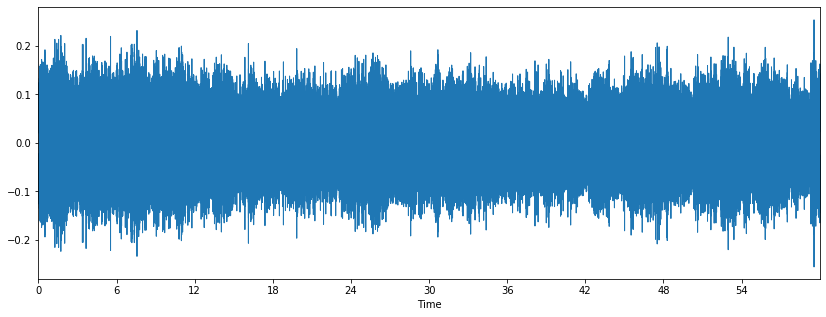

In [294]:
#display waveform
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
plt.figure(figsize=(14, 5))
librosa.display.waveplot(y, sr=sample_rate)
plt.show()

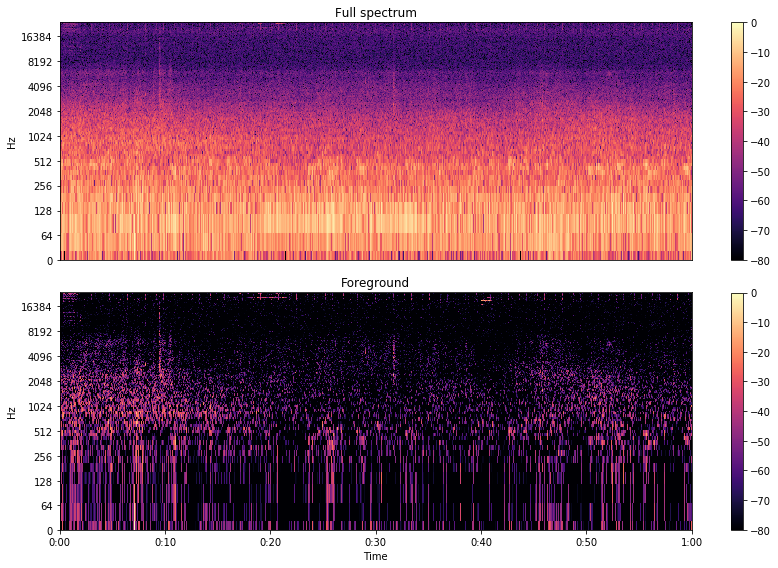

In [295]:
plt.figure(figsize=(12, 8))
plt.subplot(2, 1, 1)
librosa.display.specshow(librosa.amplitude_to_db(S_full, ref=np.max),
                         y_axis='log', sr=sample_rate,hop_length=hop_length)
plt.title('Full spectrum')
plt.colorbar()

plt.subplot(2, 1, 2)
librosa.display.specshow(librosa.amplitude_to_db(S_foreground, ref=np.max),
                         y_axis='log', x_axis='time', sr=sample_rate,hop_length=hop_length)
plt.title('Foreground')
plt.colorbar()
plt.tight_layout()

plt.show()

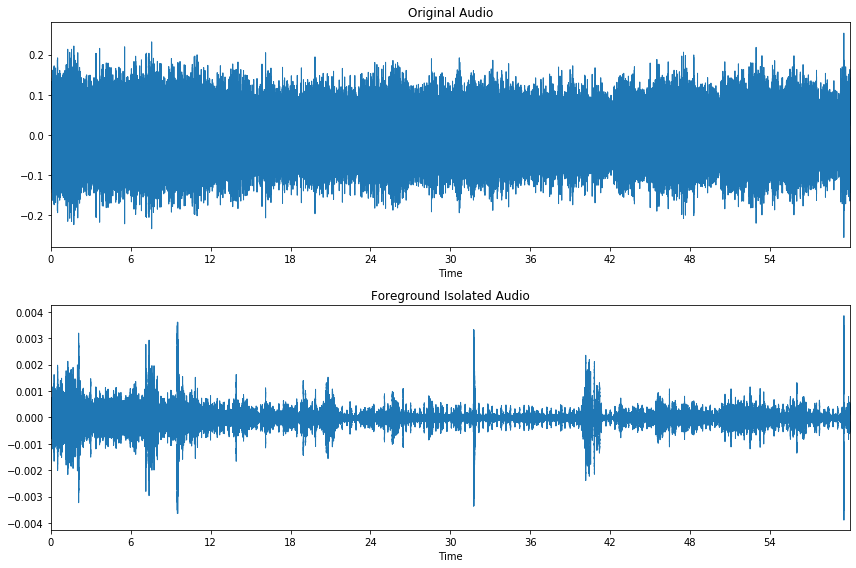

In [296]:
plt.figure(figsize=(12, 8))
plt.subplot(2, 1, 1)
librosa.display.waveplot(y, sr=sample_rate)
plt.title('Original Audio')


plt.subplot(2, 1, 2)
librosa.display.waveplot(foreground_isolated_audio, sr=sample_rate)
plt.title('Foreground Isolated Audio')
plt.tight_layout()
plt.show()

In [297]:
ipd.Audio(foreground_isolated_audio,rate=sample_rate)

In [298]:
ipd.Audio(filtered_isolation_audio,rate=sample_rate)

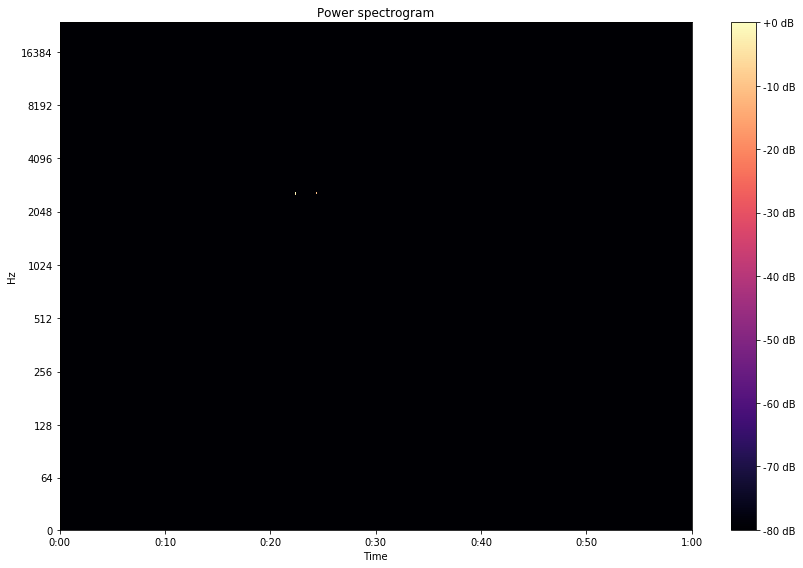

In [299]:
plt.figure(figsize=(12, 8))
librosa.display.specshow(librosa.amplitude_to_db(local_STFT_results,ref=np.max),y_axis='log', x_axis='time'
                         ,sr=sample_rate,hop_length=hop_length)
plt.title('Power spectrogram')
plt.colorbar(format='%+2.0f dB')
plt.tight_layout()

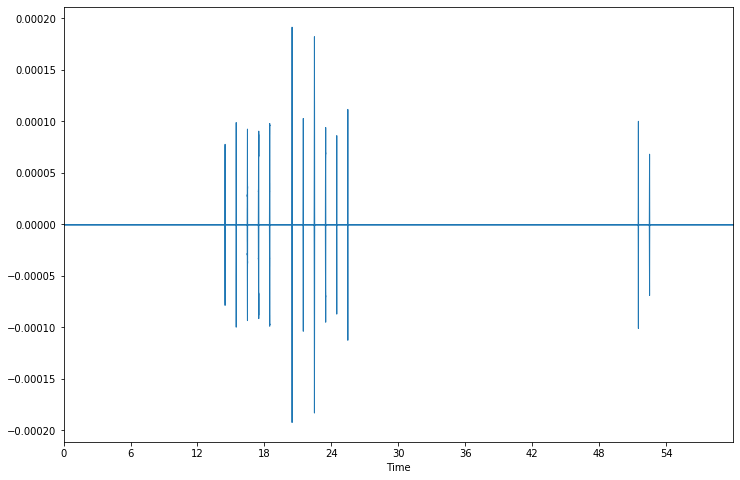

In [300]:
plt.figure(figsize=(12, 8))
librosa.display.waveplot(filtered_isolation_audio, sr=sample_rate)
plt.show()

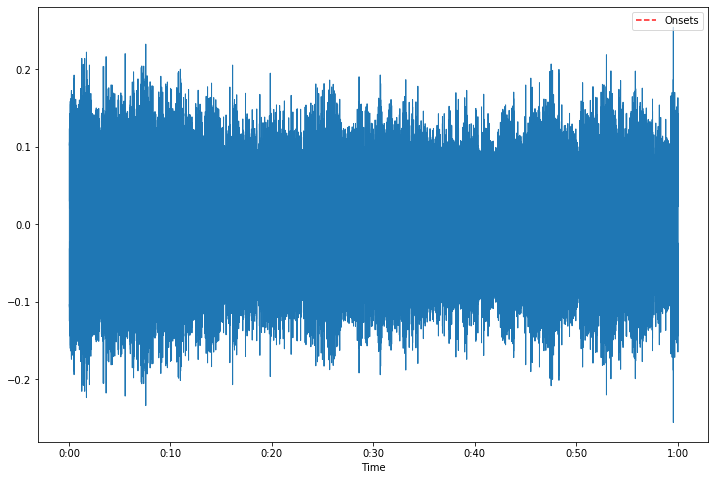

In [301]:
plt.figure(figsize=(12, 8))
librosa.display.waveplot(y, sr=sample_rate)
plt.vlines(times, np.min(y), np.max(y), color='r', alpha=0.9,
           linestyle='--', label='Onsets')
plt.axis('tight')
plt.legend(frameon=True, framealpha=0.75)
plt.show()

In [275]:
local_STFT_results,found_crosswalk = new_crosswalk_isolation(foreground_isolated_audio,
                                         frequencies=harmonic_freq_ranges,
                                         sample_rate = sample_rate,                
                                         beep_duration=beep_duration_frames,
                                         beep_period=beep_period_frames,
                                         beep_period_variance=beep_period_frames_variance,
                                         amplitude_threshold=minimum_freq_threshold_amp)

Crosswalk isolation: 100%


In [290]:
from scipy.ndimage.filters import maximum_filter1d
def new_crosswalk_isolation(audio,frequencies,sample_rate = 480000,*,beep_duration= 3,beep_period = 188,
                        beep_period_variance=3, amplitude_threshold=-999):
    """ 
    Isolate crosswalk beeping
    
    Used to isolate crosswalk beeping in audio file. Used after initial filtering for better isolation performance. 
    This zeros out elements that are not crosswalk beeping and returns that matrix.
    
    Two properties of the beeping are targeted:
        1. The duration of the beep.
        2. The period on which the beeps are occuring.
    
    Parameters: 
    data (numpy.ndarray): The Librosa STFT matrix to process for crosswalk beeping.
    freq_indexes (numpy.ndarray):The indexes of the target frequency bin of beeping.
    beep_duration (int): The length of the beep in Librosa frames.
    beep_period (int): The period of the beeps in Librosa frames.
    beep_period_variance (int): The variance in the period of the beeps in Librosa frames.
    amplitude_threshold (float): The minimum amplitude of STFT for initial filtering. If not entered, will not 
    threshold.
    
    
    Returns: 
    output_data (numpy.ndarray): The Librosa STFT matrix after crosswalk isolation.
    found_crosswalk (bool): True if found crosswalk audio, False if no crosswalk audio found.
  
    """
    print("Crosswalk isolation: 0%", end='\r')
    # Begin isolation by looking at STFT of audio.
    STFT_results = np.abs(librosa.stft(audio,n_fft=n_fft))
    
    print("Crosswalk isolation: 10%", end='\r')
    # Calculates frequency bins.
    fft_freqs = librosa.fft_frequencies(sr=sample_rate, n_fft=n_fft)

    # Collect STFT index of focus frequency ranges.
    freq_indexes = np.array([])
    for harmonic in frequencies:
        current_indexes = np.nonzero((fft_freqs>=harmonic[0]) & (fft_freqs<=harmonic[1]))[0]
        freq_indexes = np.append(freq_indexes,current_indexes)

    freq_indexes = freq_indexes.astype(int)   

    # Frequency of actual bins in ranges.
    real_freqs = fft_freqs[freq_indexes]

    # Sets all components not in crosswalk band frequency to zero.
    data = np.zeros(STFT_results.shape)
    data[freq_indexes,:] = STFT_results[freq_indexes,:]
    
    print("Crosswalk isolation: 20%", end='\r')
    # Performs thresholding on amplitude if described. Adjust "minimum_freq_threshold_db" in constants to make 
    # evaluation more or less aggressive. 
    if amplitude_threshold != -999:
        data[data < amplitude_threshold] = 0
    
    print("Crosswalk isolation: 40%", end='\r')
    data_frame_length = data.shape[1]
    freq_rows = freq_indexes.size
    found_crosswalk = False
    
    # Applies isolation per frequency bin row
    for row_ind in range(freq_rows):
        # Finds indexes in frame (effectively time) where there is nonzero amplitude.
        non_zero_row = np.nonzero(data[freq_indexes[row_ind],:])[0]
        # Used to only keep valid duration and period pulses, zeros out remaining values.
        new_row = np.zeros(data_frame_length)
       
        if non_zero_row.size > 0:
            
            pulse_duration_valid = duration_validation(non_zero_row,beep_duration)
            period_valid = period_validation(pulse_duration_valid,beep_period,beep_period_variance)
            
            
            if len(period_valid) > 1:
                # Only keeps STFT magnitude amplitude values, zeros out remainder
                new_row[period_valid] = data[freq_indexes[row_ind],period_valid]

        data[freq_indexes[row_ind],:] = new_row
    
    
    output_data = data
    #np.zeros(data.shape)
    #mean_data = np.mean(data[freq_indexes,:],axis=0)
    #
    ## Finds indexes in frame (effectively time) where there is nonzero amplitude.
    #mean_row = np.nonzero(mean_data)[0]
    ## Used to only keep valid duration and period pulses, zeros out remaining values.
    #mean_row_zero = np.zeros(data_frame_length)
    #   
    #if mean_row.size > 0:
    #        
    #    pulse_duration_valid_mean = duration_validation(mean_row,beep_duration)
    #    period_valid_mean = period_validation(pulse_duration_valid_mean,beep_period,beep_period_variance)
    #        
    #    if len(period_valid_mean) > 1:
    #            # Only keeps STFT magnitude amplitude values, zeros out remainder
    #            output_data[:,period_valid] = data[:,period_valid]
    #            found_crosswalk = True
#
    #
    print("Crosswalk isolation: 100%")
    return output_data, found_crosswalk